In [1]:
#Import Pytorch
import torch
from torch import nn, relu, sigmoid
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, datasets

#Import Copy, Numpy, Pillow and Matplotlib
from copy import deepcopy
import numpy as np
import PIL
import matplotlib.pyplot as plt

In [2]:
#Resizing the images from 224 pixels to 200 pixels
transformation = transforms.Compose([transforms.Resize((200, 200)),
                                     transforms.ToTensor()])

In [3]:
#Creating dataset using ImageFolder
train_dataset = datasets.ImageFolder(root = 'train', transform = transformation)
test_dataset = datasets.ImageFolder(root = 'test', transform = transformation)

In [4]:
#Creating DataLoader Object
traindataload = DataLoader(dataset = train_dataset, batch_size = 64, shuffle = True)
testdataload = DataLoader(dataset = test_dataset, batch_size = 16, shuffle = True)

In [5]:
#Creating a iterator using iter() method
traindataiter = iter(traindataload)
testdataiter = iter(testdataload)

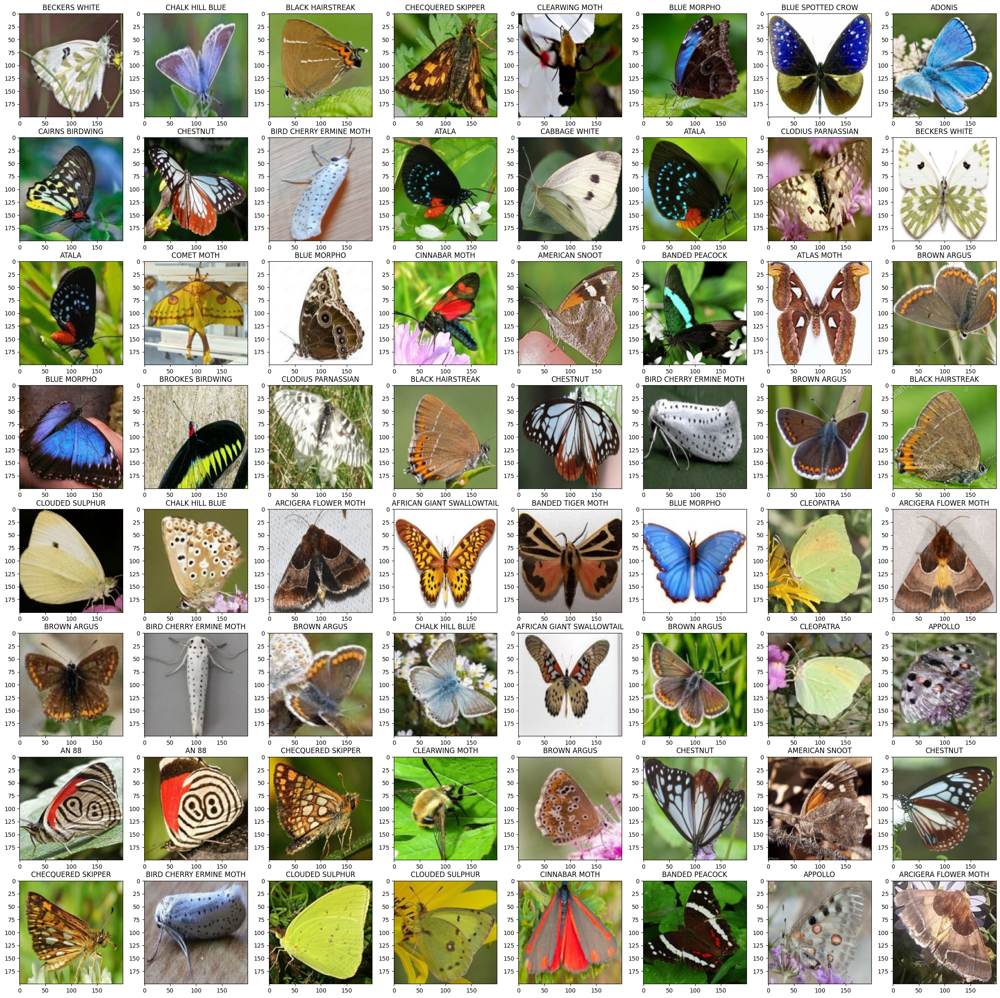

In [6]:
#Plotting the images
images, label = next(traindataiter)
fig, ax = plt.subplots(ncols = 8, nrows = 8, figsize = (30,30))
z = 0
for i in range(8):
    for j in range(8):
        ax[i][j].imshow(images[z].permute(1, 2, 0))
        ax[i][j].title.set_text(train_dataset.classes[label[z]])
        z += 1

In [7]:
#Bulding the CNN model

class ButterflyCNN(nn.Module):
    def __init__(self):
        super(ButterflyCNN, self).__init__()
        self.first_conv = nn.Conv2d(3, 9, 7, 2)
        self.first_pool = nn.MaxPool2d(7, 2)
        self.second_conv = nn.Conv2d(9, 18, 3, 1)
        self.second_pool = nn.MaxPool2d(3, 1)
        self.third_conv = nn.Conv2d(18, 36, 3, 1)
        self.third_pool = nn.MaxPool2d(3, 1)
        self.fc1 = nn.Linear(36 * 38 * 38, 31)
        
    def forward(self,x):
        x = relu(self.first_conv(x))
        x = self.first_pool(x)
        x = relu(self.second_conv(x))
        x = self.second_pool(x)
        x = relu(self.third_conv(x))
        x = self.third_pool(x)
        #Flatten the output to (batch_size, 36 * 38 * 38)
        x = x.view(x.size(0), -1)
        x = self.fc1(x)
        return x

In [8]:
model = ButterflyCNN()

In [9]:
#I have already trained the model before, you can ignore this cell if you want to train by yourself

model.load_state_dict(torch.load('best_model.pt'))
model.eval()

ButterflyCNN(
  (first_conv): Conv2d(3, 9, kernel_size=(7, 7), stride=(2, 2))
  (first_pool): MaxPool2d(kernel_size=7, stride=2, padding=0, dilation=1, ceil_mode=False)
  (second_conv): Conv2d(9, 18, kernel_size=(3, 3), stride=(1, 1))
  (second_pool): MaxPool2d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (third_conv): Conv2d(18, 36, kernel_size=(3, 3), stride=(1, 1))
  (third_pool): MaxPool2d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (fc1): Linear(in_features=51984, out_features=31, bias=True)
)

In [10]:
#Setting up criterion loss and optimizer

criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr = 0.001)

In [11]:
n_epoch = 10

In [23]:
# Initializing variables for early stopping

best_loss = float('inf')
best_model_weight = None
patience = 10
trainlosslist = []
trainaccuracy = []
testlosslist = []
testaccuracy = []

In [25]:
# Training Loop (With early stopping)

for epoch in range(n_epoch):
    # Set the model to training mode
    model.train()
    trainacc = 0.0
    trainloss = 0.0
    testacc = 0.0
    testloss = 0.0
    # Forward pass and loss calculation
    for x, y in traindataload:
        yhat = model(x)
        loss = criterion(yhat, y)
        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        val, idx = torch.max(yhat, 1)
        optimizer.step()
        
        trainloss += loss.item() * x.size(0)
        trainacc += torch.sum(idx == y.data)
    train_loss = trainloss / len(train_dataset)
    train_acc = trainacc.double() / len(train_dataset)
    trainlosslist.append(train_loss)
    trainaccuracy.append(train_acc)
    model.eval()
    
    with torch.no_grad():
        for x_, y_ in testdataload:
            yhat_ = model(x_)
            loss_ = criterion(yhat_, y_)
            val_, idx_ = torch.max(yhat_, 1)

            testloss += loss_.item() * x_.size(0)
            testacc += torch.sum(idx_ == y_.data)
        test_loss = testloss / len(test_dataset)
        test_acc = testacc.double() / len(test_dataset)
        testaccuracy.append(test_acc)
        testlosslist.append(test_loss)

    # Early stopping
    if loss_ < best_loss:
        best_loss = loss_
        best_model_weights = deepcopy(model.state_dict()) # Deep copy the best model
        patience = 10 # Resets the patience counter

    else:
        patience -= 1
        if patience == 0:
            break

# Load the best model weights
model.load_state_dict(best_model_weights)

<All keys matched successfully>

In [26]:
#Saves the model at "best_model.pt"

torch.save(model.state_dict(), 'best_model.pt')

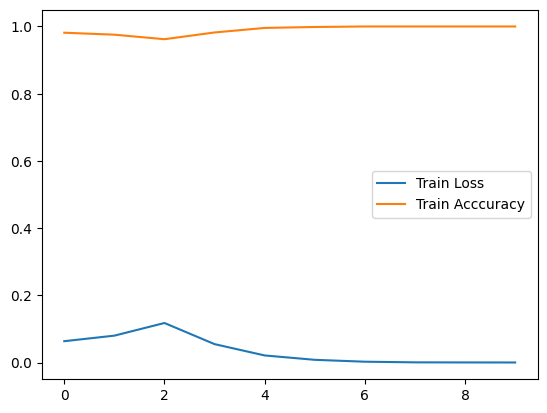

In [28]:
plt.plot(trainlosslist, label = 'Train Loss')
plt.plot(trainaccuracy, label = 'Train Acccuracy')
plt.legend()
plt.show()

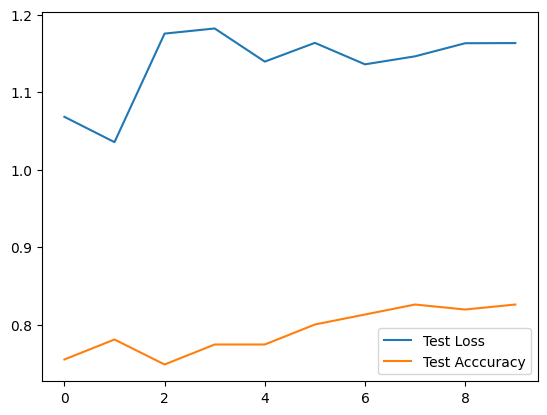

In [30]:
plt.plot(testlosslist, label = 'Test Loss')
plt.plot(testaccuracy, label = 'Test Acccuracy')
plt.legend()
plt.show()

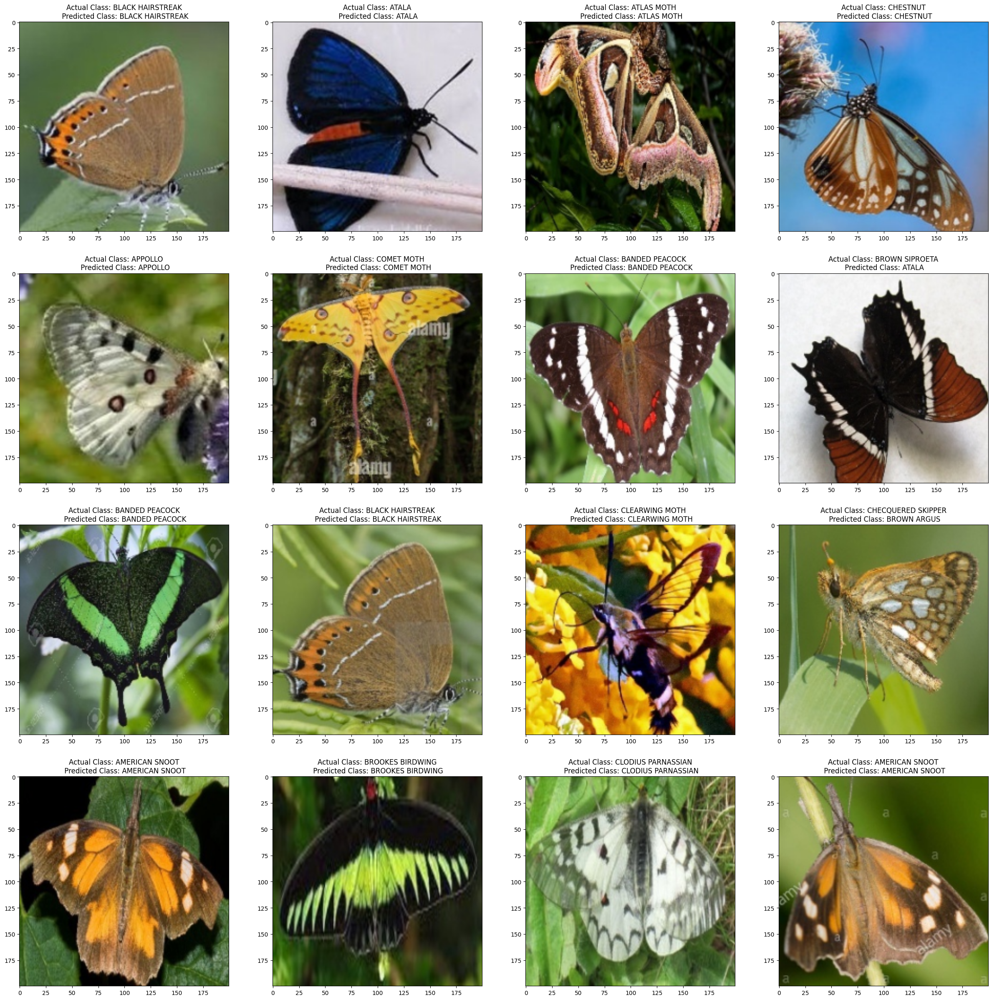

In [32]:
#Outputs trained images

images, label = next(traindataiter)
train_output = model(images)
fig, ax = plt.subplots(ncols = 4, nrows = 4, figsize = (30,30))
a = 0
for i in range(4):
    for j in range(4):
        ax[i][j].imshow(images[a].permute(1, 2, 0))
        title = 'Actual Class: {}\n Predicted Class: {}'.format(train_dataset.classes[label[a].item()], train_dataset.classes[train_output[a].argmax().item()])
        ax[i][j].title.set_text(title)
        a += 1

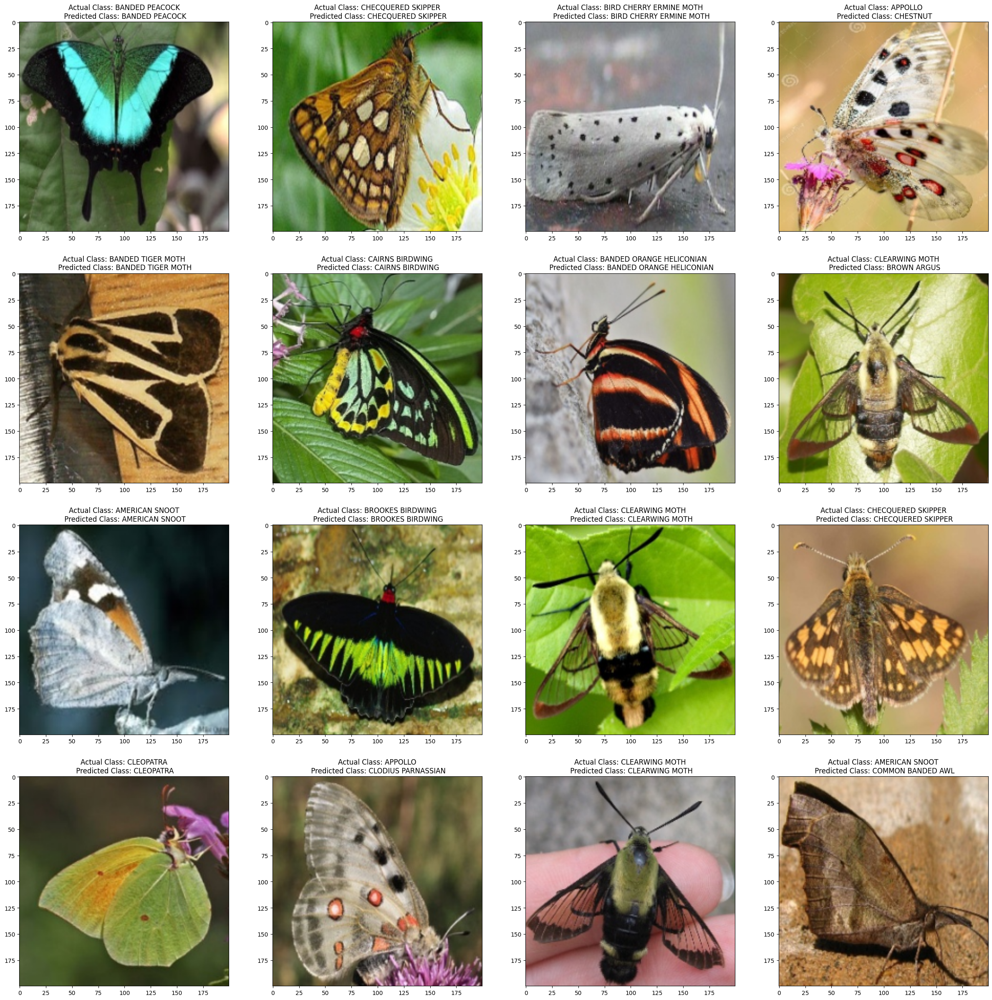

In [33]:
#Outputs test images
#We can see that there are some butterflies that are misclassified

test_images, test_label = next(testdataiter)
test_output = model(test_images)
fig, ax = plt.subplots(ncols = 4, nrows = 4, figsize = (30,30))
b = 0
for i in range(4):
    for j in range(4):
        ax[i][j].imshow(test_images[b].permute(1, 2, 0))
        title = 'Actual Class: {}\n Predicted Class: {}'.format(test_dataset.classes[test_label[b].item()], test_dataset.classes[test_output[b].argmax().item()])
        ax[i][j].title.set_text(title)
        b += 1